In [2]:
import pandas as pd
import sklearn as sk
import numpy as np


from sklearn.pipeline import Pipeline
from sklearn.metrics import confusion_matrix, accuracy_score, balanced_accuracy_score, f1_score
from sklearn.feature_extraction.text import TfidfVectorizer, HashingVectorizer
from sklearn.compose import ColumnTransformer

from sklearn.cluster import KMeans

In [2]:
ref = pd.read_csv('/home/robin/Documents/DGS/data/referentiel_dispositif.csv',sep=';',encoding='latin1')

In [8]:
preprocess = ColumnTransformer(
        [('LIB', TfidfVectorizer(sublinear_tf=True,
                                             analyzer='char',
                                             min_df=1,
                                             ngram_range=(1, 2),
                                             max_features=100,
                                             norm='l1'), 'LIBELLE'),
            ],

        remainder='passthrough')

pipeline = Pipeline([
        ('vect', preprocess),
        ('cluster', KMeans(n_clusters =150)),
    ])

pipeline2 = Pipeline([
        ('vect', preprocess),
        ('cluster', KMeans(n_clusters =100)),
    ])

In [9]:
pipeline.fit(ref[['LIBELLE']])
pipeline2.fit(ref[['LIBELLE']])

Pipeline(steps=[('vect',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('LIB',
                                                  TfidfVectorizer(analyzer='char',
                                                                  max_features=100,
                                                                  ngram_range=(1,
                                                                               2),
                                                                  norm='l1',
                                                                  sublinear_tf=True),
                                                  'LIBELLE')])),
                ('cluster', KMeans(n_clusters=100))])

In [10]:
y1 = pipeline.predict(ref[['LIBELLE']])
y2 = pipeline2.predict(ref[['LIBELLE']])
ref['label']=y1

In [11]:
from sklearn.metrics import  adjusted_rand_score

print(adjusted_rand_score(y1,y2))

0.46530769493884316


In [28]:
grouped = ref.groupby('label')
G, LIB= [],[]
for g in grouped.groups.keys():
    df = grouped.get_group(g)
    G.append(g)
    print(f'## {g} ##')
    print(df.LIBELLE.tolist())
    LIB.append(df.LIBELLE.tolist())

result = pd.DataFrame()
result['cluster'] = G
result['DCO'] = LIB

RADIOL ( ESTRADIOL) - BIOCHIMIE', 'OESTRIOL ( ESTRIOL) - BIOCHIMIE', 'OESTRONE ( ESTRONE) - BIOCHIMIE', 'PANEL MARQUEURS CARDIAQUES - BIOCHIMIE', 'PHOSPHATASES ACIDES - BIOCHIMIE', 'PHOSPHATASES ALCALINES - BIOCHIMIE', 'PHOSPHATES - BIOCHIMIE', 'PHOSPHOLIPIDES - BIOCHIMIE', 'PROTEINES DE BENCE JONES - BIOCHIMIE', 'PROTEINES DU LCR ET URINAIRES - BIOCHIMIE', 'PROTIDES TOTAUX - BIOCHIMIE', 'RECEPTEURS STEROIDIENS - BIOCHIMIE', 'TRIGLYCERIDES - BIOCHIMIE', '17-CETOSTEROIDES - BIOCHIMIE']
## 74 ##
['CANULE pour ECMO', 'CANULE pour CEC', 'CAPTEUR DE DEBIT pour CEC', 'CAPTEUR DE PAO2 pour CEC', 'CIRCUIT ou PACK pour CEC', 'CIRCUIT ou PACK pour ECMO', 'CONSOLE pour CEC', 'CONSOLE pour ECMO', 'ECHANGEUR THERMIQUE pour CEC', 'FILTRE pour CEC']
## 75 ##
["DISPOSITIF D' EXPLORATION FONCTIONNELLE RESPIRATOIRE", "DISPOSITIF D' OCCLUSION VASCULAIRE", 'DISPOSITIF DE FERMETURE DE POINTS DE PONCTION', "DISPOSITIF D' ASPIRATION", "DISPOSITIF D' IRRIGATION / ASPIRATION", 'DISPOSITIF DE LAVAGE', 'DISPOSIT

In [29]:
result.to_json('cluster_on_dco.json')

In [12]:
# compare model with data

In [3]:
data = pd.read_csv('/home/robin/Documents/DGS/data/declaration_mrv_complet.csv')
import

In [6]:
data = data.fillna(' ')
data['label'] = data['DCO']+' '+data['TEF_ID'].map(str)+' '+data['CDY_ID'].map(str)+' '+data['TDY_ID'].map(str)+' '+data['FABRICANT']

In [7]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
data['label_enc'] = le.fit_transform(data['label'])

In [42]:
group = data.groupby(by ='label_enc')
L = list(group.groups.keys())


In [43]:
L

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100,
 101,
 102,
 103,
 104,
 105,
 106,
 107,
 108,
 109,
 110,
 111,
 112,
 113,
 114,
 115,
 116,
 117,
 118,
 119,
 120,
 121,
 122,
 123,
 124,
 125,
 126,
 127,
 128,
 129,
 130,
 131,
 132,
 133,
 134,
 135,
 136,
 137,
 138,
 139,
 140,
 141,
 142,
 143,
 144,
 145,
 146,
 147,
 148,
 149,
 150,
 151,
 152,
 153,
 154,
 155,
 156,
 157,
 158,
 159,
 160,
 161,
 162,
 163,
 164,
 165,
 166,
 167,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 179,
 180,
 181,
 182,
 183,
 184,


<AxesSubplot:xlabel='label_enc'>

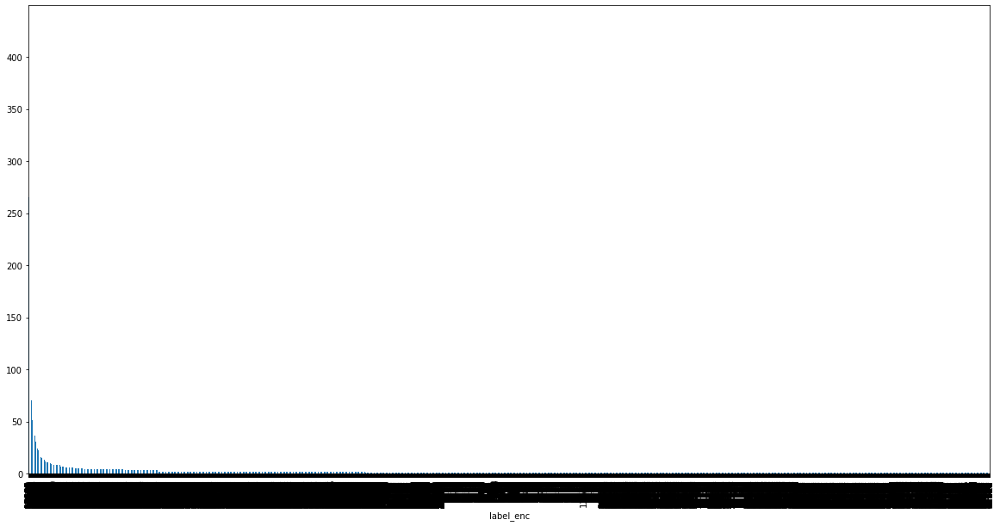

In [21]:
data.groupby('label_enc').count()['DCO'].sort_values(ascending=False).plot(kind='bar',figsize =(20,10))

In [20]:
L = data.groupby('label_enc').count()['DCO'].sort_values(ascending=False)
L[:100]

label_enc
13856    428
13887    414
13889    382
13859    370
29869    324
        ... 
14183     70
13938     68
14143     68
14227     68
14543     67
Name: DCO, Length: 100, dtype: int64

In [20]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
data['GRAVITE'] = le.fit_transform(data['GRAVITE'].fillna(' '))
data['TEF_ID'] = data['TEF_ID'].fillna('E0').map(lambda x: float(x[1:]))
data['TDY_ID'] = data['TDY_ID'].fillna('T0').map(lambda x: float(x[1:]))
data['CDY_ID'] = data['CDY_ID'].fillna('C0').map(lambda x: float(x[1:]))


In [22]:
X = data[['DCO_ID','TEF_ID','CDY_ID','TDY_ID','GRAVITE']].fillna('0')
cluster = KMeans(n_clusters =150)
y = cluster.fit_predict(X)

In [35]:
import joblib
import os
name = '06_10_2020'
cluster_2 = joblib.load(os.path.join('/home/robin/Documents/DGS/Annexe/L3/',name,'cluster',name+'.sav'))
topic_model_mat = pd.read_pickle(os.path.join('/home/robin/Documents/DGS/Annexe/L3/',name,'LDA',name+'.pkl'))
def add_col(df,col,X):
        df_used = pd.DataFrame()
        for c in col : 
            df[c] = df[c].astype('category')
            df_used[c] = df[c].cat.codes
            X_new = np.concatenate((X,df_used.values),axis=1)
        return X_new
col= ['TYPE_DECLARANT', 'FABRICANT','REFERENCE_COMMERCIALE','CLASSIFICATION']
n = 152
X_1= topic_model_mat.iloc[:,:n-1].values
X_2 = add_col(data,col,X_2)


In [33]:
y_2 = cluster_2.predict(X_2)

In [34]:
print(adjusted_rand_score(y,y_2))

0.18810991649848216
